# **PROBLEM STATEMENT** -
**A retail store that has multiple outlets across the country are facing issues in managing the
inventory - to match the demand with respect to supply. You are a data scientist, who has to
come up with useful insights using the data and make prediction models to forecast the sales for
X number of months/yea**rs.

## **Data Set Infomation**

*italicized text*![image.png](attachment:60fb9722-91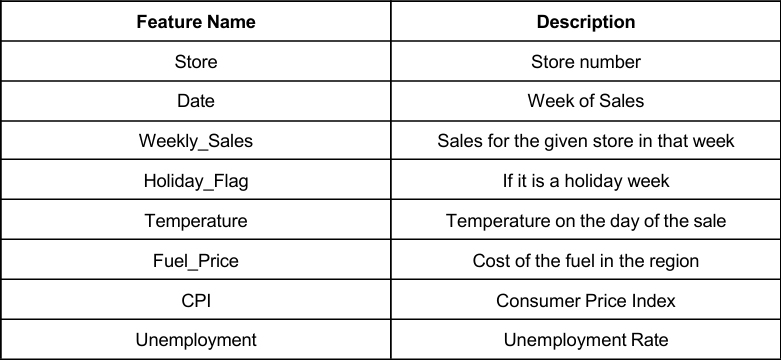c1-41df-9cb3-d470cbe833a5.png)

# OBJECTIVE
1. You are provided with the weekly sales data for their various outlets. Use statistical analysis, EDA, outlier analysis, and handle the missing values to come up with various insights that can give them a clear perspective on the following:
- If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?
- If the weekly sales show a seasonal trend, when and what could be the reason?
- Does temperature affect the weekly sales in any manner?
- How is the Consumer Price index affecting the weekly sales of various stores?
- Top performing stores according to the historical data.
- The worst performing store, and how significant is the difference between the highest and lowest performing stores.
2. Forecast the sales for each store for the next 12 weeks.

In [11]:
# importing necessary librarys
import pandas as pd   # manipulation of data
import numpy as np    # numrical python

import matplotlib.pyplot as plt  # visualization
import seaborn as sns
import matplotlib.ticker as ticker


In [12]:
# for time series forecasting
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, mean_squared_error


In [13]:
# avoid warnings
import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore', ConvergenceWarning)

In [14]:
df=pd.read_csv('Walmart DataSet.csv') # loading dataset

In [ ]:
# dataset link - https://drive.google.com/file/d/19R3MArsp6i9tTScc_yuAaIGaH8o-9JLK/view

In [5]:
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


In [6]:
df.tail()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
6430,45,28-09-2012,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,05-10-2012,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,12-10-2012,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,19-10-2012,718125.53,0,56.47,3.969,192.330854,8.667
6434,45,26-10-2012,760281.43,0,58.85,3.882,192.308899,8.667


In [7]:
df.shape

(6435, 8)

In [15]:
df['Date']=pd.to_datetime(df['Date'], dayfirst=True)

In [10]:
df.dtypes

Store                    int64
Date            datetime64[ns]
Weekly_Sales           float64
Holiday_Flag             int64
Temperature            float64
Fuel_Price             float64
CPI                    float64
Unemployment           float64
dtype: object

In [19]:
df.isnull().sum()


Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64

In [21]:
df.duplicated().sum()

0

In [17]:
df.set_index("Date",inplace=True,drop=True)

In [13]:
df.head()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
Date,,,,,,,
2010-02-05,1,1643690.90,0,42.31,2.572,211.096358,8.106
2010-02-12,1,1641957.44,1,38.51,2.548,211.242170,8.106
2010-02-19,1,1611968.17,0,39.93,2.514,211.289143,8.106
2010-02-26,1,1409727.59,0,46.63,2.561,211.319643,8.106
2010-03-05,1,1554806.68,0,46.50,2.625,211.350143,8.106


In [25]:
pd.set_option('display.float_format', '{:,}'.format)  # formating the digits
df.describe().round(2)

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,"6,435.0","6,435.0","6,435.0","6,435.0","6,435.0","6,435.0","6,435.0"
mean,23.0,"1,046,964.88",0.07,60.66,3.36,171.58,8.0
std,12.99,"564,366.62",0.26,18.44,0.46,39.36,1.88
min,1.0,"209,986.25",0.0,-2.06,2.47,126.06,3.88
25%,12.0,"553,350.1",0.0,47.46,2.93,131.74,6.89
50%,23.0,"960,746.04",0.0,62.67,3.44,182.62,7.87
75%,34.0,"1,420,158.66",0.0,74.94,3.74,212.74,8.62
max,45.0,"3,818,686.45",1.0,100.14,4.47,227.23,14.31


#  About data
-  The  walmart data has  6435 row , 8 columns
-  It contains 143 weeks  during the period of '2010-02-05' to '2012-10-26'
-  Walmart has 45 stores
-  data is cleaned no missing value and no duplicates
-  The highest weekly sales out of all store is 3,818,686 and lowest is 209,986 
-  highest cost of fuel are 4.47 and lowest are 2.47 
-  The maximum consumer price index is measured is  227.23 and minmum is 126.06
-  The maximum unemployment rate  is measured is  14.31 and minmum is 3.88
-  In weekly Sales there can be outliers 

In [23]:
cols=df.columns
cols=cols.drop('Store')

In [25]:
store_list=df['Store'].unique()
store_list

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45], dtype=int64)

# Visualization for all stores in line plot

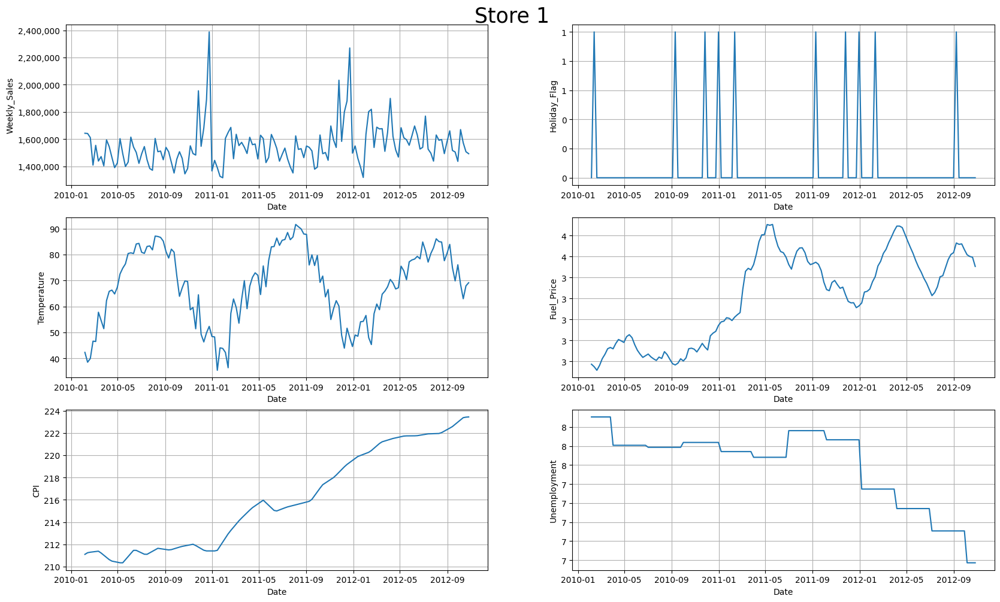

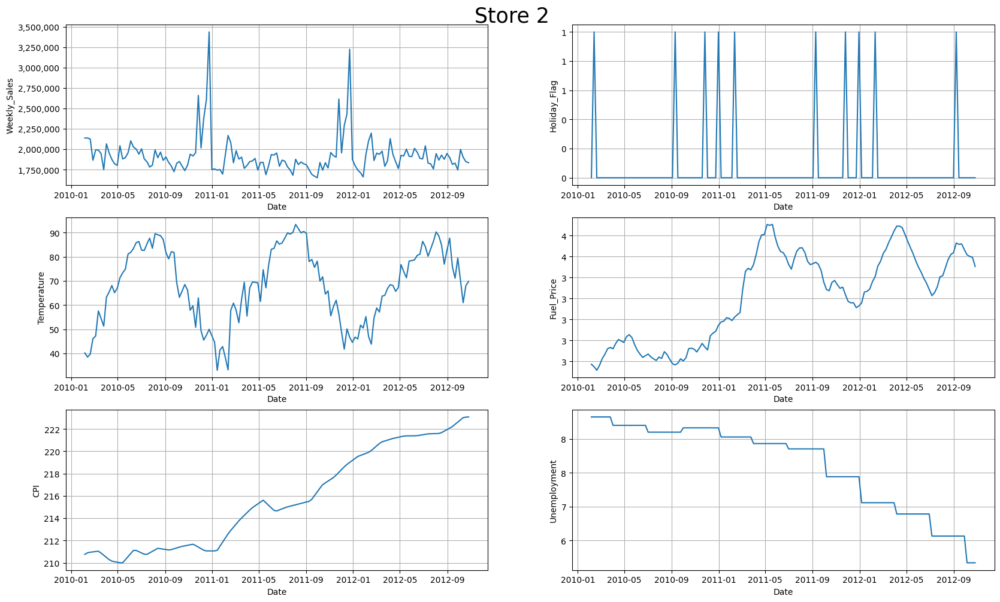

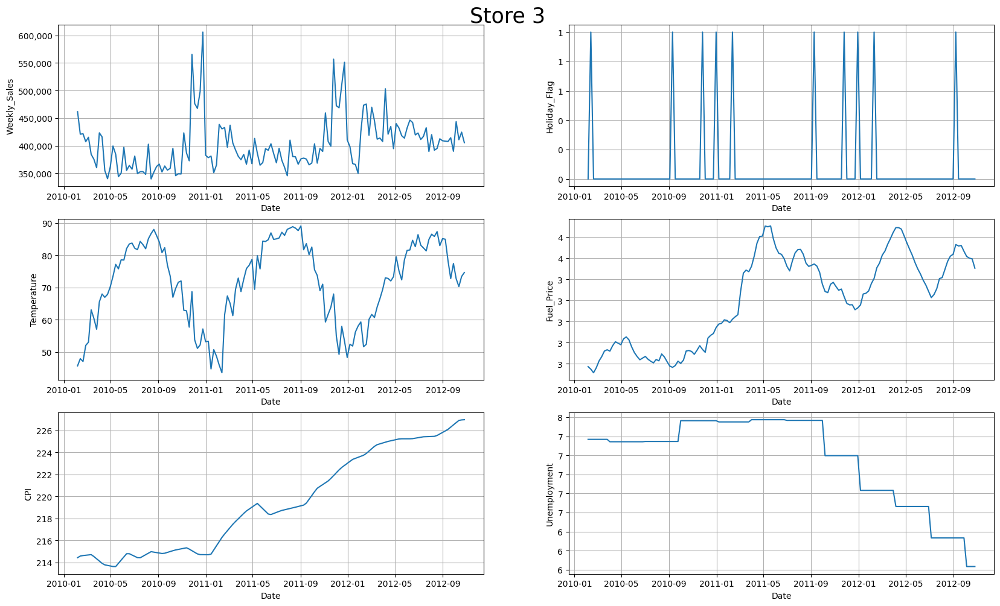

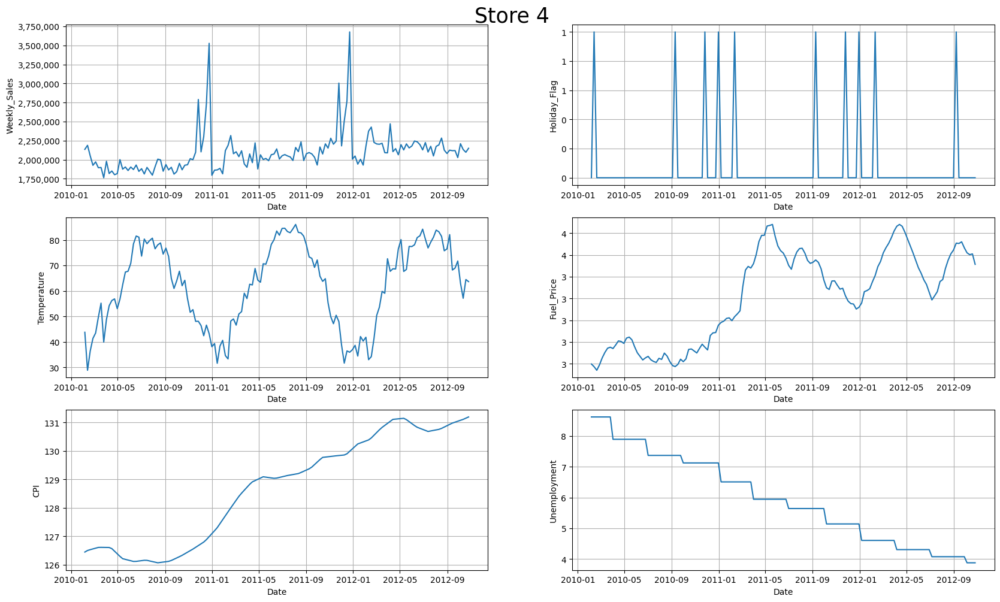

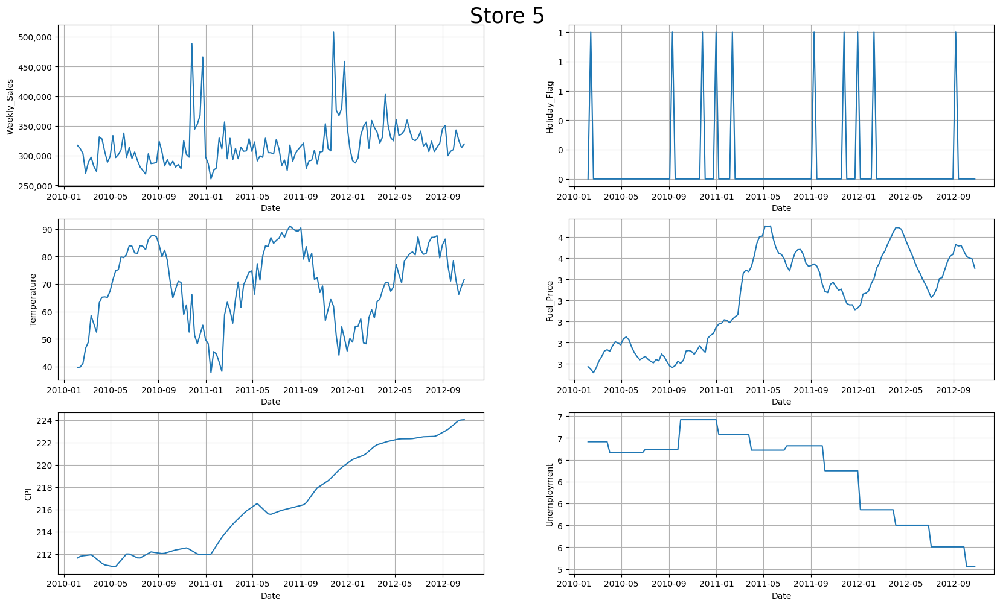

...

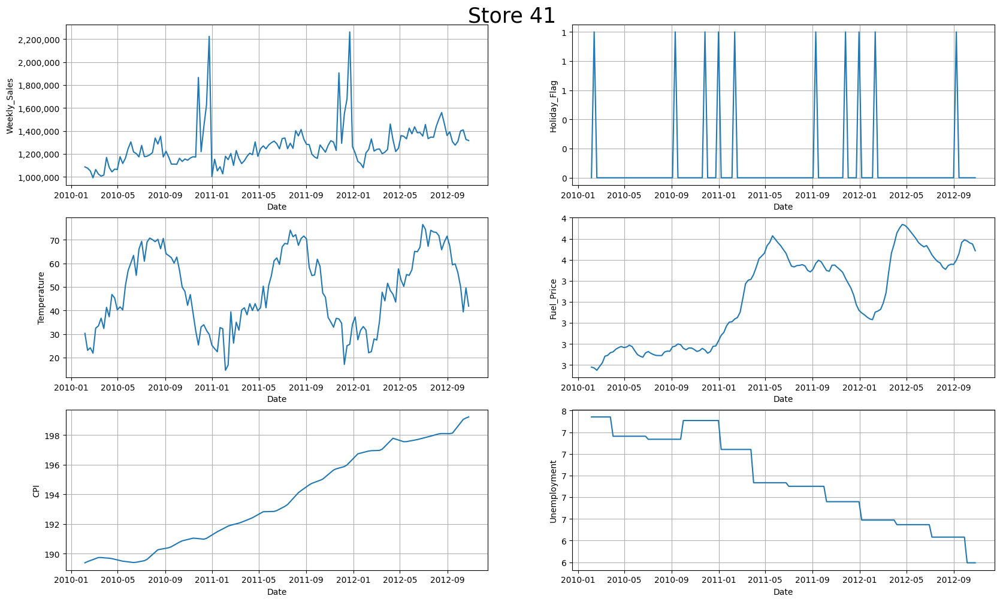

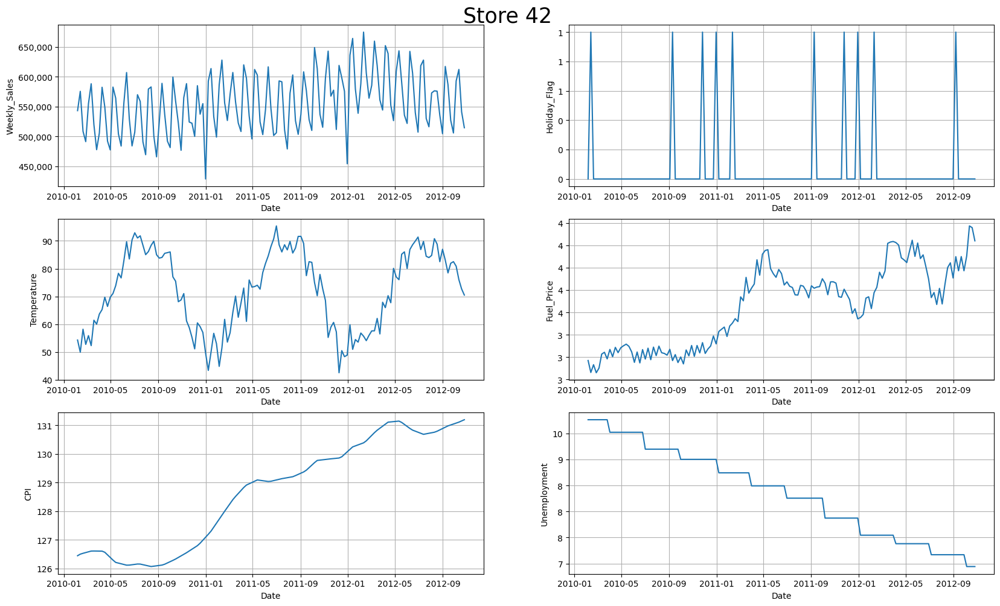

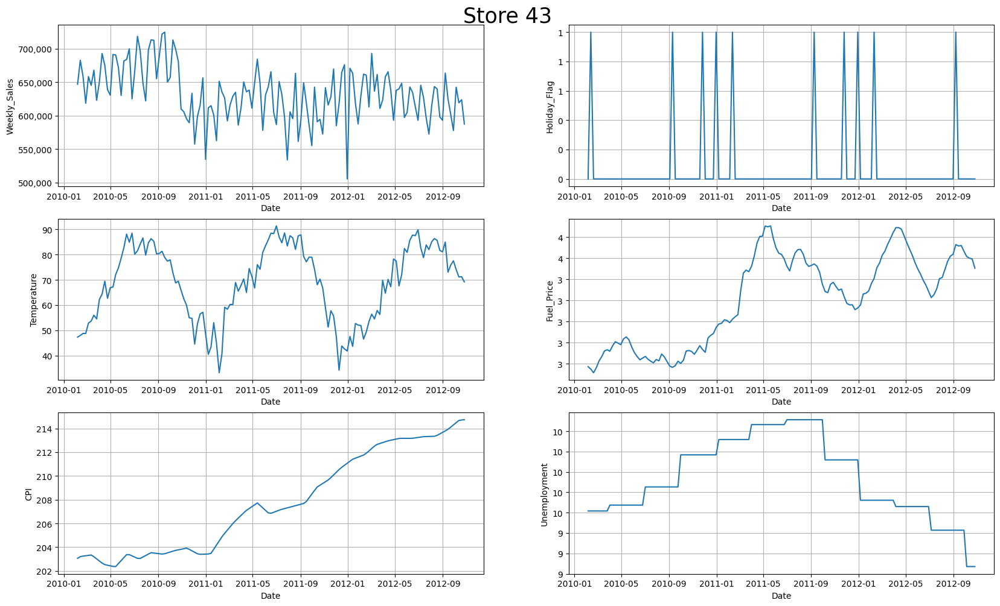

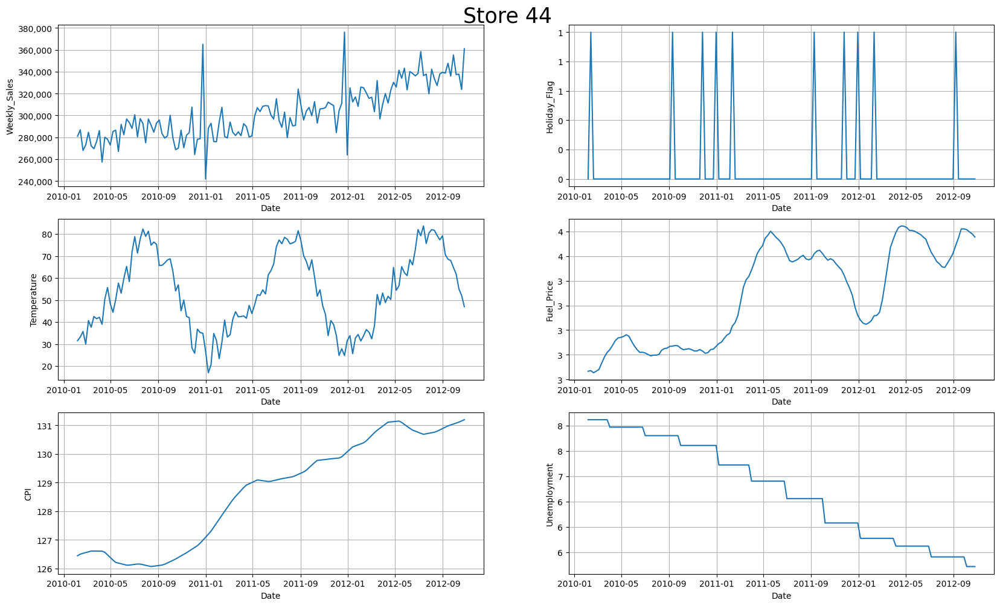

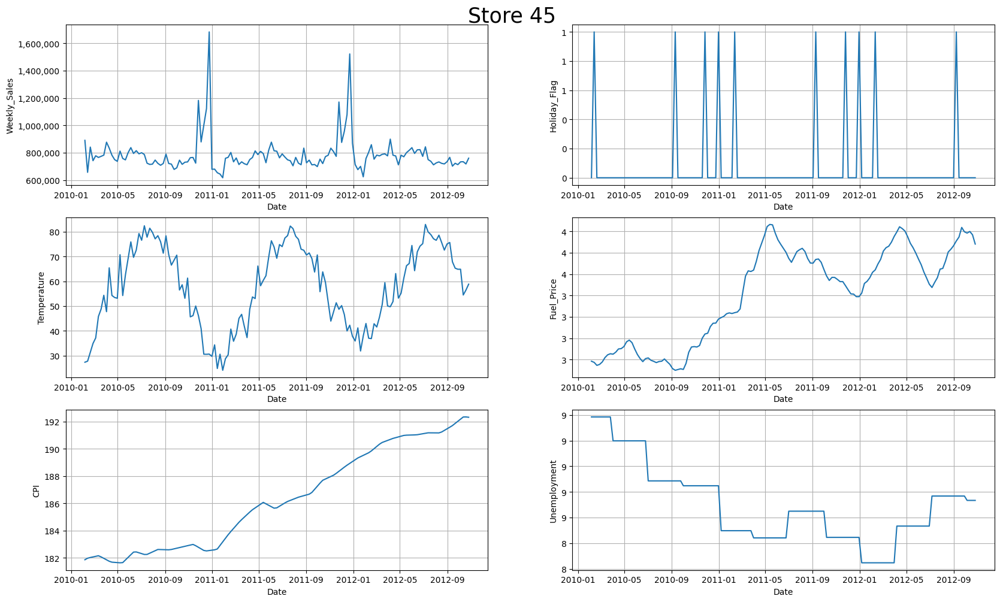

In [233]:
y=0
for z in store_list :

    x=1
    plt.figure(figsize=(20,16))

    for i in cols:
        plt.subplot(4,2,x)
        ax = sns.lineplot(data=df.iloc[y:y+143],x=df.iloc[y:y+143].index,y=i)
        ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}')) # for y axis formating
        plt.suptitle(f'Store {z} ',y=0.9,fontsize=25,)
        plt.grid()
        x+=1
    y+=143


# insights and patterns shows  in stores
- Most of the stores achieve there highest sales of the year in between month of november to december so demand of inventory is high for most of the stores.
- All stores In between month of january to febuary have a most downward spike means having minmum sales of the year .
- Store number - 33, 36, 38, 42, 43  that shows different pattern or seasonality in weekly sales from most of the stores because of might be  these stores have a avg unemployeement rate > 8 and having a less sales compare to other's stores avrage sales
- The only store 36 have a downward trend in weekly sales ,This store is continous decrease in sales .




In [27]:
store={}
x=1
y=0
for a in store_list:
    store[x]=df.iloc[y:y+143]
    x+=1
    y+=143


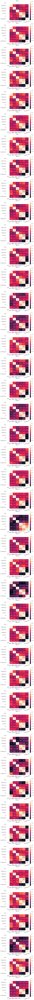

In [213]:
plt.figure(figsize=(7,250))
x=1
for i in store_list:
    plt.subplot(45,1,x)
    sns.heatmap(store[i].corr(),annot=True)
    plt.xticks(rotation=15)
    plt.title(f'Store {i}')
    x+=1
        
     

# Insights from above heatmap
- From above heatmap correlation a common thing with all stores is that **Consumer price index** of each stores is directly proportional to **Fuel Price**  they has a Strong positive correlation means Clear upward trend.
- Most of the stores  are strong negative correlation between there  **Consumer price index** and **Unemployement rate**  means Clear downward trends.
- Exception - **store 24** shows different correlation  between **Consumer price index** and **Unemployement rate** it has a positive correlation of 0.86 where all other stores have a negative correlation between them .
  

# Distrubution of data points

Text(0.5, 1.0, 'Temperature vs Fuel_Price')

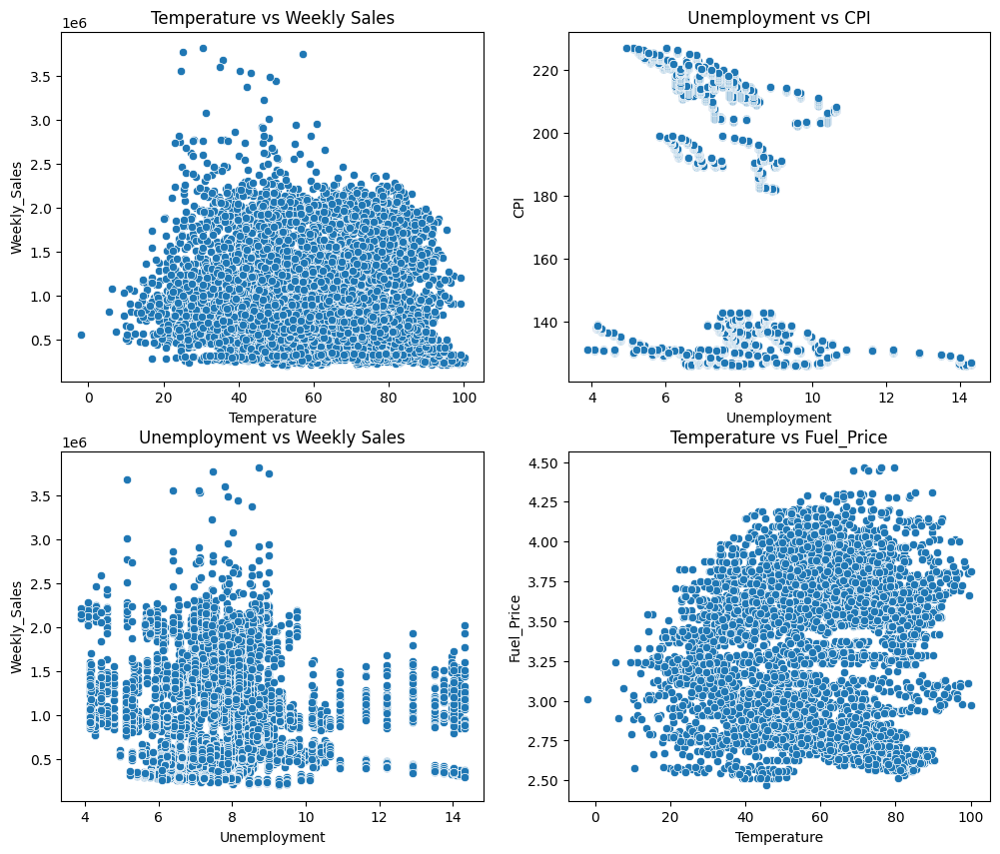

In [80]:
plt.figure(figsize=(12,10))
plt.subplot(2,2,1)
sns.scatterplot( x='Temperature',y='Weekly_Sales', data=df)
plt.title('Temperature vs Weekly Sales')


plt.subplot(2,2,2)
sns.scatterplot(x='Unemployment',y='CPI', data=df)
plt.title(' Unemployment vs CPI ')


plt.subplot(2,2,3)
sns.scatterplot(x='Unemployment', y='Weekly_Sales', data=df)
plt.title('Unemployment vs Weekly Sales')


plt.subplot(2,2,4)
sns.scatterplot(x='Temperature', y='Fuel_Price', data=df)
plt.title('Temperature vs Fuel_Price')


#
- The highest weekly sales are achive in Temprature between 20 to 60
- Most of the High CPI lying between 6 to 11 unemployment rate
- Most of the higher weekly sales values occur when unemployment rate is between 5 to 9.
- High density  in Temprature 20 to 90 of fule price 2.5 to 4.25  

In [29]:
pivot_df = df.pivot( columns="Store", values="Weekly_Sales")  # converting data with weekly sales into stores with respect to weekly dates
pivot_df

Store,1,2,3,4,5,6,7,8,9,10,...,36,37,38,39,40,41,42,43,44,45
Date,,,,,,,,,,,,,,,,,,,,,
2010-02-05,1643690.90,2136989.46,461622.22,2135143.87,317173.10,1652635.10,496725.44,1004137.09,549505.55,2193048.75,...,467546.74,536006.73,358496.14,1230596.80,1001943.80,1086533.18,543384.01,647029.28,281090.95,890689.51
2010-02-12,1641957.44,2137809.50,420728.96,2188307.39,311825.70,1606283.86,524104.92,994801.40,552677.48,2176028.52,...,469563.70,529852.70,342214.90,1266229.07,955338.29,1075656.34,575709.96,682918.99,286857.13,656988.64
2010-02-19,1611968.17,2124451.54,421642.19,2049860.26,303447.57,1567138.07,506760.54,963960.37,511327.90,2113432.58,...,470281.03,510382.50,327237.92,1230591.97,916289.20,1052034.74,508794.87,658997.55,267956.30,841264.04
2010-02-26,1409727.59,1865097.27,407204.86,1925728.84,270281.63,1432953.21,496083.24,847592.11,473773.27,2006774.96,...,447519.44,513615.82,334222.73,1168582.02,863917.41,991941.73,491510.58,618702.79,273079.07,741891.65
2010-03-05,1554806.68,1991013.13,415202.04,1971057.44,288855.71,1601348.82,491419.55,881503.95,507297.88,1987090.09,...,480203.43,519255.68,372239.89,1266254.21,990152.28,1063557.49,554972.42,658600.05,284617.27,777951.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2012-09-28,1437059.26,1746470.56,389813.02,2027620.23,310141.68,1369131.46,525545.76,884724.41,516361.06,1694862.41,...,270677.98,527953.14,398468.08,1495607.07,919595.44,1307928.01,505978.46,577792.32,355307.94,713173.95
2012-10-05,1670785.97,1998321.04,443557.65,2209835.43,343048.29,1518177.71,505830.56,976436.02,606755.30,1758971.38,...,277137.86,546122.37,458479.01,1574408.67,1069112.00,1400160.95,593162.53,642614.89,337390.44,733455.07
2012-10-12,1573072.81,1900745.13,410804.39,2133026.07,325345.41,1459396.84,503463.93,927511.99,558464.80,1713889.11,...,300236.85,521810.75,437320.66,1494417.07,982523.26,1409544.97,612379.90,619369.72,337796.13,734464.36


In [35]:
max_sales=[]
min_sales=[]
avg_sales=[]

for i in store_list:

    max_sales.append(pivot_df[i].max())
    min_sales.append(pivot_df[i].min())
    avg_sales.append(pivot_df[i].mean())

In [39]:
dt={
    "max_sales" : max_sales,
    "min_sales" : min_sales,
    "avg_sales" : avg_sales
}
dt=pd.DataFrame(dt,index= range (1,46))



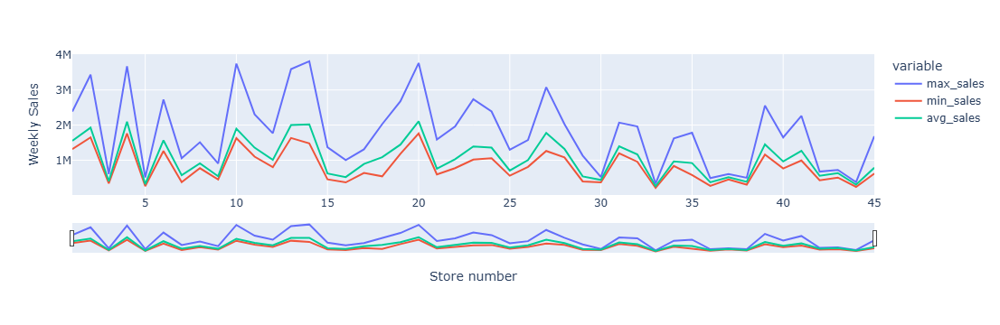

In [41]:
import plotly.express as px

fig = px.line(dt,labels={'index': 'Store number', 'value': ' Weekly Sales'})
fig.update_xaxes(rangeslider_visible=True)
fig.show()

# 
- The highest **Maximum**  weekly sales is **3.8186 M** of **store 14** and lowest maximum weekly sales is **331.1735 k** of **store 33**
- The highest **Minmum** weekly sales is **1.7625 M** of **store 4** and lowest minimum weekly sales is **209.9863 k** of **store 33**
- The highest **Average** weekly sales is **2.107677 M** of **store 20** and lowest average weekly sales is **259.8617 k** of **store 33**
- The **store 33** Perform very bad in sales in  all condition this store required more attention
 

In [43]:
resamp=pivot_df.resample('A').sum().round(2)

In [45]:
resamp=resamp.T


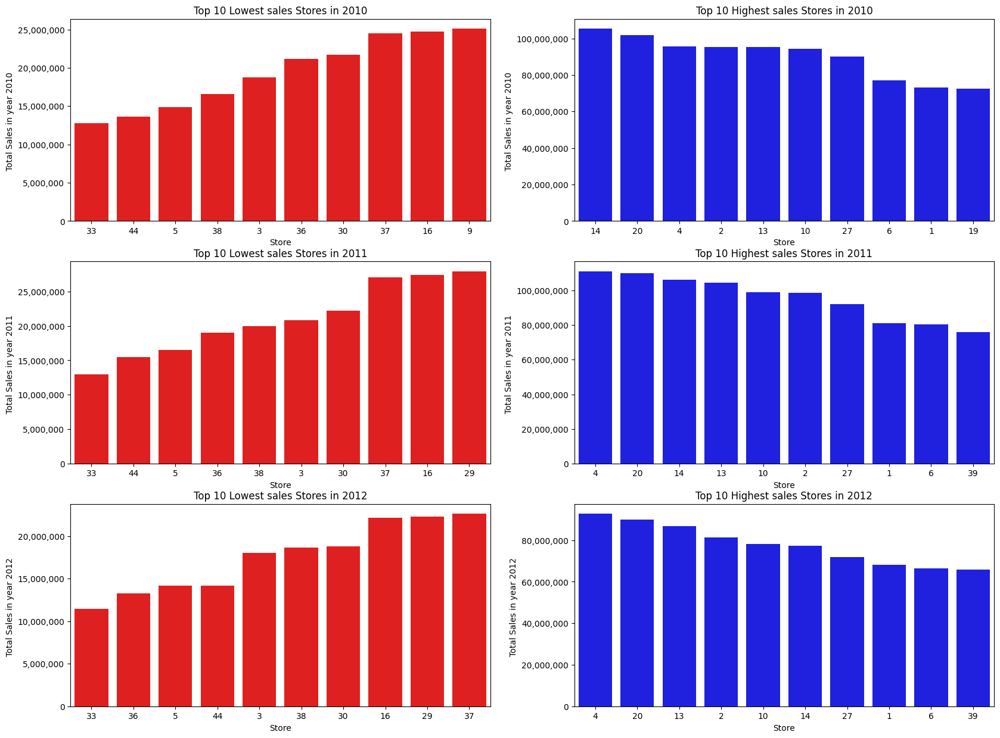

In [47]:
x=2010
y=1
plt.figure(figsize=(20,15))
for i in resamp.columns:
    sort=resamp.sort_values(i)

    plt.subplot(3,2,y)
    px=sns.barplot(x=sort.head(10).index,y=sort[i].head(10),order=sort.head(10).index,color='r')
    plt.ylabel(f'Total Sales in year {x} ')
    plt.title(f'Top 10 Lowest sales Stores in {x}')
    px.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    y+=1
    plt.subplot(3,2,y)
    px=sns.barplot(x=sort.tail(10).index,y=sort[i].tail(10),order=sort.tail(10)[::-1].index,color='b')
    plt.ylabel(f'Total Sales in year {x} ')
    plt.title(f'Top 10 Highest sales Stores in {x}')
    px.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    y+=1
    x+=1



In [45]:
rsp=pivot_df.sum()
rsp=rsp.sort_values()

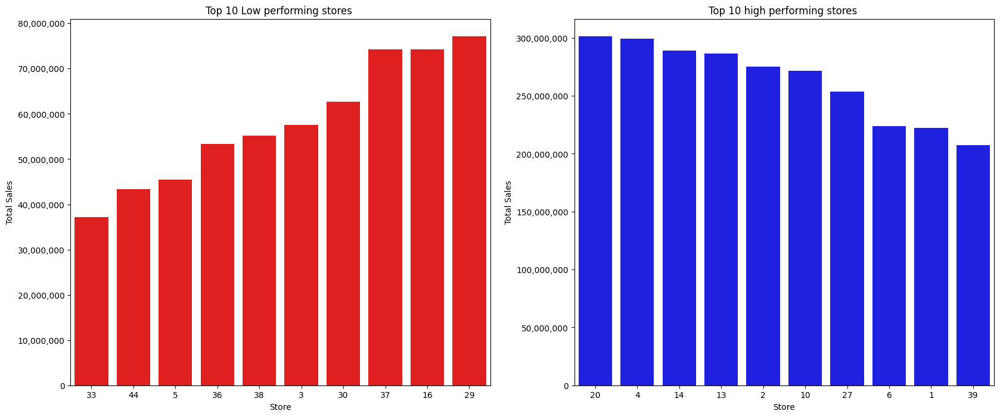

In [53]:
plt.figure(figsize=(20,8))
plt.subplot(1,2,1)
px=sns.barplot(x=rsp.head(10).index,y=rsp.head(10),order=rsp.head(10).index,color='r')
plt.ylabel('Total Sales')
plt.title('Top 10 Low performing stores ')
px.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))

plt.subplot(1,2,2)
px=sns.barplot(x=rsp.tail(10).index,y=rsp.tail(10),order=rsp.tail(10)[::-1].index,color='b')
plt.ylabel('Total Sales')
plt.title('Top 10 high performing stores ')
px.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))

In [65]:
pd.set_option('display.float_format', '{:,}'.format) 
rsp.round(2)

Store
33    37,160,221.96
44    43,293,087.84
5      45,475,688.9
36    53,412,214.97
38    55,159,626.42
3     57,586,735.07
30    62,716,885.12
37    74,202,740.32
16     74,252,425.4
29    77,141,554.31
9     77,789,218.99
42    79,565,752.43
7     81,598,275.14
15    89,133,683.92
43    90,565,435.41
25   101,061,179.17
21   108,117,878.92
45   112,395,341.42
17   127,782,138.83
8    129,951,181.13
35   131,520,672.08
40   137,870,309.79
34    138,249,763.0
26   143,416,393.79
12   144,287,230.15
22   147,075,648.57
18   155,114,734.21
32   166,819,246.16
41   181,341,934.89
28   189,263,680.58
11    193,962,786.8
24   194,016,021.28
23   198,750,617.85
31    199,613,905.5
19    206,634,862.1
39   207,445,542.47
1    222,402,808.85
6    223,756,130.64
27   253,855,916.88
10   271,617,713.89
2    275,382,440.98
13    286,517,703.8
14   288,999,911.34
4    299,543,953.38
20   301,397,792.46
dtype: float64

# Outlier detection

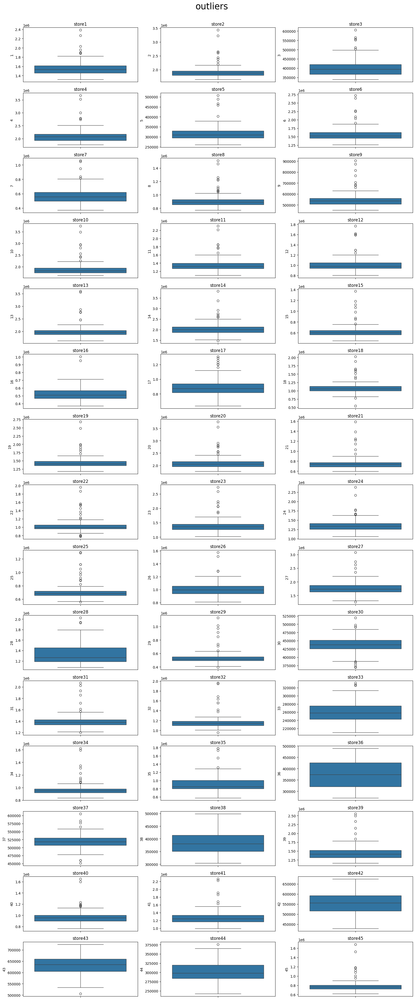

In [49]:
plt.figure(figsize=(20,50))
x=1
plt.suptitle("outliers",y=0.9,fontsize=25)
for i in store_list:
    plt.subplot(15,3,x)  
    sns.boxplot(data =pivot_df[i])
    plt.title(f"store{i}")
    x+=1

1) If the weekly sales are affected by the unemployment rate, if yes - which stores are suffering the most?
- yes weekly sales are affected by the unemployement rate the most suffering stores are store 38 and store 44 they both have a inversly porportional relation between weekly sales and unemployment rate.  

2.  The weekly sales show a seasonal trend ?  when and what could be the reason?
- Weekly sales have a seasonal trend it repeat after a one year .
- In a data set  a similar  pattern spikes can be seens in every year
- The reason behind the seasonal trend depends on many factor one of the factor is Temparture . Temparature have also a similar pattern in every year ,another factor CPI is high  or low in pirticular seasonal intervel so sales are also have seasonal trend , other are economic and environmental factor 

3. Does temperature affect the weekly sales in any manner?
-  Not so much but yes temperature affect the weekly sales . The most of the stores  highest weekly sales are in Temprature between 20 to 60  



4. The worst performing store, and how significant is the difference between the highest and lowest performing stores.
- store 33 is worst performing store . The difference between sales in highest and lowest performing stores is  ( 301,397,792.46 -  37,160,221.96 ) = 264,237,570.49

In [51]:
# split data into training and testing
train=pivot_df.iloc[:120]
test=pivot_df.iloc[120:]

In [53]:
# checking the Stationarity in weekly sales
non_stationarity_stores=[]
stationarity_stores=[]
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import kpss
        
for i in store_list :
    ADF = adfuller(train[i])
    KPSS= kpss(train[i])

    if ADF[1] < 0.05 and KPSS[1]>0.05:
        print(f' Stationarity is present in store {i}')
        stationarity_stores.append(i)
    else :
        print(f' No stattionarity is present in store {i} ')
        non_stationarity_stores.append(i)

 No stattionarity is present in store 1 
 Stationarity is present in store 2
 No stattionarity is present in store 3 
 No stattionarity is present in store 4 
 No stattionarity is present in store 5 
 Stationarity is present in store 6
 Stationarity is present in store 7
 Stationarity is present in store 8
 No stattionarity is present in store 9 
 Stationarity is present in store 10
 Stationarity is present in store 11
 Stationarity is present in store 12
 Stationarity is present in store 13
 Stationarity is present in store 14
 Stationarity is present in store 15
 Stationarity is present in store 16
 No stattionarity is present in store 17 
 Stationarity is present in store 18
 Stationarity is present in store 19
 Stationarity is present in store 20
 Stationarity is present in store 21
 Stationarity is present in store 22
 Stationarity is present in store 23
 Stationarity is present in store 24
 Stationarity is present in store 25
 Stationarity is present in store 26
 Stationarity is 

In [55]:
# log transformation of data 
from scipy.stats import boxcox
df_st_box={}
for i in store_list :
    df_st_box[i]=pd.Series(boxcox(train[i],lmbda=0),index=train[i].index)

# Model Building for prediction 

In [25]:
'''
from pmdarima import auto_arima
odr=[]
s_odr=[]
for i in stationarity_stores :
    model = auto_arima(
    train[i],
    seasonal=True,
    m=52, 
    max_p=3,     # limit max p
    max_d=1,     # limit max d
    max_q=3,     # limit max q
    max_P=2,     # limit seasonal P
    max_D=1,     # limit seasonal D
    max_Q=2,     # limit seasonal Q
    suppress_warnings=True,
    stepwise=True         # Faster stepwise search
    )

    # Print the chosen orders
    print("Non-seasonal order (p, d, q):", model.order)
    odr.append(model.order)
    print("Seasonal order (P, D, Q, m):", model.seasonal_order)
    s_odr.append(model.seasonal_order)
'''
# takes a lot of time 

Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (3, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 1, 52)
Non-seasonal order (p, d, q): (0, 0, 1)
Seasonal order (P, D, Q, m): (0, 1, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (3, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (2, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-seasonal order (p, d, q): (3, 0, 2)
Seasonal order (P, D, Q, m): (1, 0, 0, 52)
Non-

In [57]:

sr_model={}
sarimax_preds=[]

for i in stationarity_stores :
    sr_model[i] = SARIMAX(df_st_box[i], order=(2,0,2),seasonal_order=(1,0,0,52))  
    sr_model[i] = sr_model[i].fit()
    train_len=120
    sr_preds=sr_model[i].predict(start=train_len,end=len(pivot_df[1])-1)
    sarimax_preds.append(sr_preds)
   

In [59]:
Sarimax_preds=[]
for i in range (0,27):
    Sarimax_preds.append(np.exp(sarimax_preds[i])) 

In [61]:
x=0
mae={}
mse={}
rmse={}
mape={}
for i in stationarity_stores :
    
    mae[i] = mean_absolute_error(test[i], Sarimax_preds[x]).round(2)
    mse[i] = mean_squared_error(test[i], Sarimax_preds[x]).round(2)
    rmse[i] = np.sqrt(mse[i]).round(2)

    mape[i] = (np.mean(np.abs((test[i]-  Sarimax_preds[x]) /test[i])) * 100).round(2)
    x+=1
  

In [63]:
result1=pd.DataFrame([mae,rmse,mape],index=['MAE','RMSE','MAPE %'])
pd.set_option('display.float_format', '{:,}'.format)

In [65]:
result1=result1.T

In [67]:
result1

,MAE,RMSE,MAPE %
2,"48,423.71","57,956.55",2.54
6,"35,003.04","44,010.01",2.2
7,"35,470.88","41,539.94",6.14
8,"26,394.6","31,336.59",2.88
10,"50,266.31","60,840.34",2.83
11,"44,822.15","59,590.35",3.39
12,"44,251.07","49,133.41",4.59
13,"74,317.43","86,542.89",3.63
14,"239,741.03","273,751.72",14.71
15,"21,137.43","28,413.05",3.43


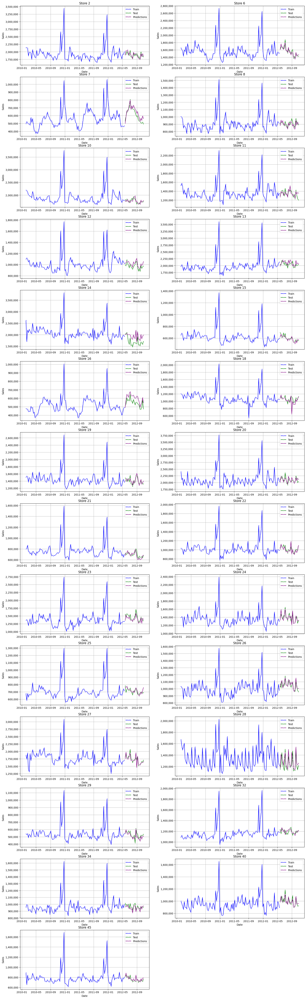

In [69]:
plt.figure(figsize=(20,130))
x=1
y=0
for i in stationarity_stores:
    plt.subplot(26,2,x)
    sns.lineplot(data = train[i], marker = '.', color = 'blue', label = 'Train')
    sns.lineplot(data = test[i], marker = '.', color = 'green', label = 'Test')
    ax=sns.lineplot(x =  Sarimax_preds[y].index, y =  Sarimax_preds[y].values, marker = '.', color = 'purple', label = 'Predictions')
    ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    plt.ylabel('Sales')
    plt.title(f'Store {i}')
    plt.grid()
    x+=1
    y+=1

In [71]:
df_box_diff={}
for i in non_stationarity_stores :
   df_box_diff[i]=df_st_box[i].diff()
    
    

In [73]:
for i in non_stationarity_stores :
    ADF = adfuller(df_box_diff[i].dropna())
    KPSS= kpss(df_box_diff[i].dropna())

    if ADF[1] < 0.05 and KPSS[1]>0.05:
        print(f' Stationarity is present in store {i}')
       
    else :
        print(f' No stattionarity is present in store {i} ')
       

 Stationarity is present in store 1
 Stationarity is present in store 3
 Stationarity is present in store 4
 Stationarity is present in store 5
 Stationarity is present in store 9
 Stationarity is present in store 17
 Stationarity is present in store 30
 Stationarity is present in store 31
 Stationarity is present in store 33
 Stationarity is present in store 35
 Stationarity is present in store 36
 Stationarity is present in store 37
 Stationarity is present in store 38
 Stationarity is present in store 39
 Stationarity is present in store 41
 Stationarity is present in store 42
 Stationarity is present in store 43
 No stattionarity is present in store 44 


In [75]:

sarimax_preds2={}
for i in non_stationarity_stores :
    sr_model[i] = SARIMAX( df_box_diff[i], order=(2,0,2),seasonal_order=(1,0,0,52))  
    sr_model[i] = sr_model[i].fit()
    train_len=120
    sr_preds2=sr_model[i].predict(start=train_len,end=len(pivot_df[1])-1)
    sarimax_preds2[i]=sr_preds2
    

In [77]:
# Append the predictions with 'df_boxcox_diff' to prepare the data for inverse transformation
df_boxcox_diff_pred={}
df_preds={}

for i in non_stationarity_stores:
    df_boxcox_diff_pred[i]=pd.concat([df_box_diff[i],sarimax_preds2[i]])   #appended series
    df_preds[i]=df_boxcox_diff_pred[i].cumsum()    # cummulative series
    df_preds[i]=df_preds[i].add(df_st_box[i][0])   # initial value adjustment
    df_preds[i]=np.exp(df_preds[i])   #exponential series
    

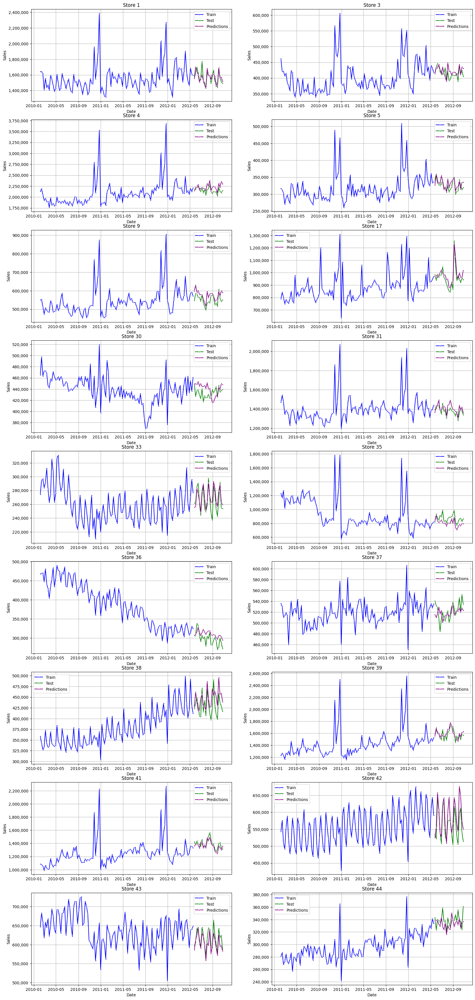

In [79]:
plt.figure(figsize=(20,130))
x=1
y=0
for i in non_stationarity_stores:
    plt.subplot(26,2,x)
    sns.lineplot(data = train[i], marker = '.', color = 'blue', label = 'Train')
    sns.lineplot(data = test[i], marker = '.', color = 'green', label = 'Test')
    ax=sns.lineplot(x = df_preds[i].iloc[120:].index, y = df_preds[i].iloc[120 :].values, marker = '.', color = 'purple', label = 'Predictions')
    ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    plt.ylabel('Sales')
    plt.title(f'Store {i}')
    plt.grid()
    x+=1
    y+=1

In [81]:
mae2={}
mse2={}
rmse2={}
mape2={}
for i in non_stationarity_stores :
    
    mae2[i] = mean_absolute_error(test[i], df_preds[i].iloc[120:]).round(2)
    mse2[i] = mean_squared_error(test[i], df_preds[i].iloc[120:]).round(2)
    rmse2[i] = np.sqrt(mse2[i]).round(2)

    mape2[i] = ((np.mean(np.abs((test[i]-  df_preds[i].iloc[120:]) /test[i])) * 100)).round(2)
  
    

In [83]:
result2=pd.DataFrame([mae2,rmse2,mape2],index=['MAE','RMSE','MAPE %'])
result2=result2.T

In [85]:
result=pd.concat([result1,result2])

In [87]:
result=result.sort_index()

# Performance of model

In [89]:
result # store wise performance matrics

,MAE,RMSE,MAPE %
1,"36,757.57","51,360.53",2.29
2,"48,423.71","57,956.55",2.54
3,"11,927.95","15,820.36",2.9
4,"81,089.21","99,403.95",3.8
5,"9,955.61","12,337.36",3.1
6,"35,003.04","44,010.01",2.2
7,"35,470.88","41,539.94",6.14
8,"26,394.6","31,336.59",2.88
9,"26,464.56","31,530.88",4.86
10,"50,266.31","60,840.34",2.83


# Forcast for  future 12 weeks sales  

In [109]:

forecast={}
forecast_values={}
sarima_ci={}
for i in stationarity_stores :
    forecast[i]=sr_model[i].get_forecast(steps=35)
    forecast_values[i]=np.exp(forecast[i].predicted_mean)
    forecast_values[i]= forecast_values[i].loc['2012-11-02':]
    sarima_ci[i] =(np.exp(forecast[i].conf_int())).loc['2012-11-02':]
   

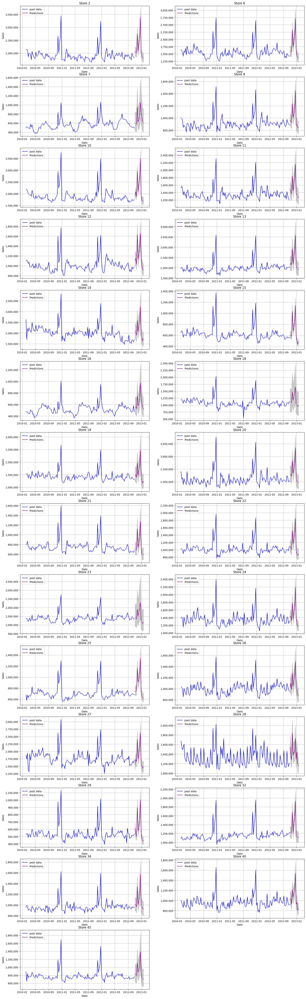

In [111]:
plt.figure(figsize=(20,130))
x=1
for i in stationarity_stores:
    plt.subplot(26,2,x)
    sns.lineplot(data = pivot_df[i], marker = '.', color = 'blue', label = 'past data')
    ax=sns.lineplot(x = forecast_values[i].index, y =  forecast_values[i].values, marker = '.', color = 'purple', label = 'Predictions')
    ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    plt.fill_between(sarima_ci[i].index,sarima_ci[i].iloc[:, 0], sarima_ci[i].iloc[:, 1], color='k', alpha=.2)
    plt.ylabel('Sales')
    plt.title(f'Store {i}')
    plt.grid()
    x+=1

In [95]:
dff_box_diff={}
dff_box={}
for i in non_stationarity_stores :
    dff_box[i]=pd.Series(boxcox(pivot_df[i],lmbda=0),index=pivot_df.index)
    dff_box_diff[i]=dff_box[i].diff()
    

In [215]:

df_boxcox_diff_pred={}
df_preds={}
for i in non_stationarity_stores :
    
    forecast[i]=sr_model[i].get_forecast(steps=35)
    df_boxcox_diff_pred[i]=pd.concat([dff_box_diff[i],forecast[i].predicted_mean])   #appended series
    df_preds[i]=df_boxcox_diff_pred[i].cumsum()    # cummulative series
    df_preds[i]=df_preds[i].add(df_st_box[i][0])   # initial value adjustment
    df_preds[i]=np.exp(df_preds[i])
    forecast_values[i]=df_preds[i].iloc[:-13:-1]
    sarima_ci[i]= forecast[i].conf_int().iloc[-1:-13:-1]

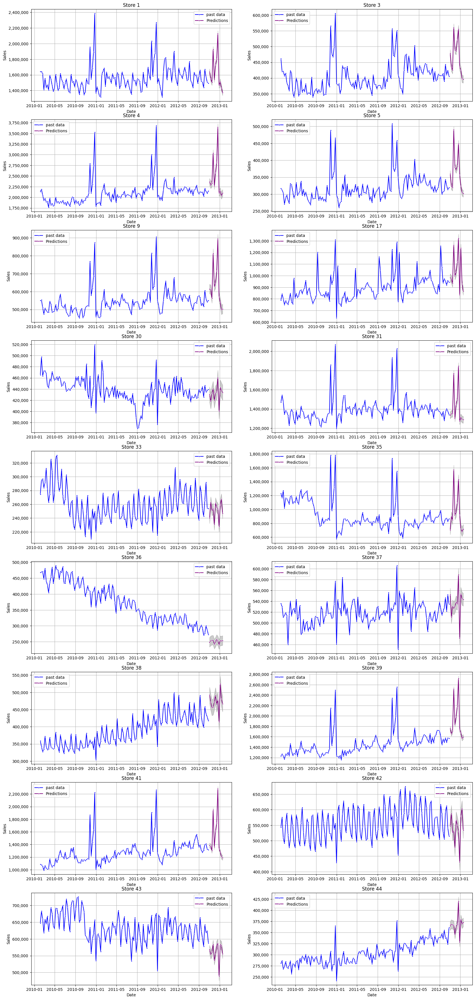

In [225]:
plt.figure(figsize=(20,130))
x=1
y=0
for i in non_stationarity_stores:
    plt.subplot(26,2,x)
    sns.lineplot(data = pivot_df[i], marker = '.', color = 'blue', label = 'past data')
    ax=sns.lineplot(x =  forecast_values[i].index, y = forecast_values[i].values, marker = '.', color = 'purple', label = 'Predictions')
    ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    plt.fill_between(forecast_values[i].index,forecast_values[i].values-result['MAE'][i], forecast_values[i].values+result['MAE'][i], color='k', alpha=.2)
    # finding a confidance interval with range of each (-MAE,+MAE) (Mean Absolute Error)
    plt.ylabel('Sales')
    plt.title(f'Store {i}')
    plt.grid()
    x+=1

# Forecast sales of 12 weeks with store wise

In [229]:
forecast_sales=pd.DataFrame(forecast_values)
forecast_sales=forecast_sales.T
forecast_sales=forecast_sales.sort_index()
forecast_sales=forecast_sales.T.round(2)
forecast_sales

,1,2,3,4,5,6,7,8,9,10,...,36,37,38,39,40,41,42,43,44,45
2012-11-02,"1,640,083.96","2,067,392.32","478,212.18","2,362,681.9","359,905.06","1,571,766.13","601,287.28","970,402.89","614,339.51","1,914,912.08",...,"248,632.51","552,091.96","491,884.7","1,754,787.84","1,021,747.71","1,383,972.5","547,074.36","567,894.88","364,776.33","839,430.11"
2012-11-09,"1,548,998.35","2,028,147.46","433,262.3","2,289,086.89","322,943.82","1,586,609.4","592,568.31","940,454.61","610,629.74","2,089,525.32",...,"253,150.35","510,650.11","471,178.29","1,658,590.09","1,045,710.52","1,370,601.3","587,380.73","553,412.61","368,981.42","807,667.09"
2012-11-16,"1,502,399.06","2,007,389.83","425,402.32","2,327,630.42","319,693.76","1,571,857.49","576,750.22","921,688.03","562,456.28","1,879,412.8",...,"254,973.0","530,667.17","455,622.25","1,711,767.84","924,623.06","1,300,759.66","526,601.96","560,222.75","367,581.98","786,621.08"
2012-11-23,"1,926,770.07","2,759,154.35","560,723.58","3,033,571.33","490,126.52","2,321,457.76","961,083.64","1,241,530.53","812,420.3","2,967,253.29",...,"254,963.57","526,914.98","457,025.03","2,515,430.86","1,218,969.73","1,947,434.82","531,295.66","583,326.53","366,427.78","1,112,476.55"
2012-11-30,"1,541,416.66","2,062,363.54","489,436.89","2,268,308.2","379,410.17","1,740,035.39","626,283.61","1,007,168.11","628,476.23","2,079,300.54",...,"243,013.16","530,380.96","471,287.58","1,833,373.7","1,065,554.01","1,361,337.69","478,062.82","535,824.95","345,721.68","875,331.7"
2012-12-07,"1,726,654.92","2,417,903.29","486,231.27","2,575,740.06","371,584.71","1,962,422.61","684,868.08","1,068,645.39","643,866.45","2,443,651.11",...,"248,487.19","538,030.32","490,639.21","1,979,662.76","1,154,949.66","1,607,766.28","566,755.9","554,494.46","362,440.83","934,320.55"
2012-12-14,"1,798,835.93","2,565,623.72","521,978.37","2,819,059.75","382,237.47","2,095,404.94","747,392.48","1,131,823.6","713,740.35","2,568,291.31",...,"257,083.53","535,522.36","465,642.15","2,183,681.1","1,190,773.08","1,735,780.47","551,128.94","580,617.68","368,086.22","1,048,183.13"
2012-12-21,"2,127,423.55","3,401,944.59","555,968.63","3,642,965.25","449,151.24","2,724,328.83","1,059,827.11","1,452,983.96","893,918.26","3,506,974.93",...,"252,769.98","589,032.58","478,108.32","2,718,383.54","1,546,483.75","2,281,289.28","530,844.7","586,770.77","420,032.85","1,395,784.26"
2012-12-28,"1,465,393.15","1,977,294.06","435,712.85","2,103,587.64","356,303.85","1,644,821.42","835,939.16","884,444.04","569,314.21","1,941,263.04",...,"241,400.84","471,800.58","414,390.08","1,738,455.32","927,589.2","1,333,664.71","431,413.49","488,893.68","328,294.08","869,061.2"
2013-01-04,"1,510,189.43","1,900,063.17","424,819.22","2,142,217.52","323,171.91","1,436,469.42","739,321.56","896,959.82","540,493.42","1,693,733.2",...,"253,511.87","553,901.44","524,395.51","1,680,129.3","969,551.27","1,278,993.12","579,467.93","583,886.58","379,668.24","724,731.26"


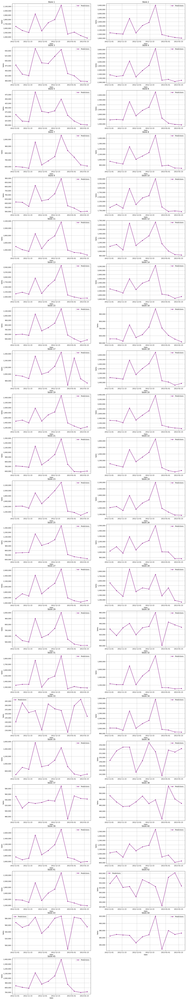

In [231]:
plt.figure(figsize=(20,130))
x=1
for i in store_list:
    plt.subplot(26,2,x)
    ax=sns.lineplot(x = forecast_sales[i].index, y = forecast_sales[i].values, marker = 'o', color = 'purple', label = 'Predictions')
    ax.yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    plt.ylabel('Sales')
    plt.xlabel('Date')
    plt.title(f'Store {i}')
    plt.grid()
    x+=1